In [13]:
import numpy as np
import dicom 
import os

In [16]:
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot,iplot

In [17]:
init_notebook_mode(connected = True)

In [18]:
input_folder = './Test2/09171700/'
patients = os.listdir(input_folder)
patients.sort()
lstDCM = []

In [19]:
def load_scan(dir):
    for dirName,subdirList, fileList in os.walk(dir):
        for filename in fileList:
            lstDCM.append(os.path.join(dirName,filename))
    return lstDCM 

In [ ]:
first_patient = load_scan(input_folder)
refDS = dicom.read_file(lstDCM[0])
pixel_dim = (int(refDS.Rows),int(refDS.Columns),int(len(lstDCM)))
print(pixel_dim)
pixel_spacing = (float(refDS.PixelSpacing[0]),float(refDS.PixelSpacing[1]),float(refDS.SliceThickness))
print(pixel_spacing)
x = np.arange(0.0,(pixel_dim[0]+1)*(pixel_spacing[0]),pixel_spacing[0])
y = np.arange(0.0,(pixel_dim[1]+1)*(pixel_spacing[1]),pixel_spacing[1])
z = np.arange(0.0,(pixel_dim[2]+1)*(pixel_spacing[2]),pixel_spacing[2])

array_dicom = np.zeros(pixel_dim,dtype = refDS.pixel_array.dtype)
for filename in lstDCM:
    da = dicom.read_file(filename)
    array_dicom[:,:,(int(da.InstanceNumber)-1)] = da.pixel_array

(512, 512, 892)
(0.3125, 0.3125, 1.0)


In [ ]:
array_dicom.shape
#sliceX = array_dicom[:,:,60]

In [8]:
ma = go.Heatmap(z = np.flipud(sliceX))
f = [ma]
iplot(f, filename='adas')

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [8]:
result = (array_dicom < 1600) * array_dicom
result = (result > 1100) * result
from skimage.filters import threshold_otsu
thres_min = threshold_otsu(result)
boolean_binary = (result > thres_min)
binary = 1 * boolean_binary

In [9]:
dupl = array_dicom[:,:,138]
#dupl[100,106] = 1
#dupl[365,128] = 1
thresh = [go.Heatmap(z = np.flipud(dupl))]
iplot(thresh,filename='basic-heatmap')

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [12]:
sliceBin = binary[:,:,184]

In [25]:
kernel = np.ones([43,22],dtype = int)

In [12]:
import SimpleITK as sitk
import matplotlib.pyplot as plt

In [ ]:
def sitk_show(img, title = None, margin = 0.05, dpi = 40):
    nda = sitk.GetArrayFromImage(img)
    spacing = img.GetSpacing()
    figsize = (1 + margin)*nda.shape[0] / dpi, (1+ margin)* nda.shape[1] / dpi
    extent = (0, nda.shape[1]*spacing[1], nda.shape[0]*spacing[0],0)
    fig = plt.figure(figsize = figsize, dpi=dpi)
    ax = fig.add_axes([margin, margin, 1-2*margin, 1-2*margin])
    
    plt.set_cmap("gray")
    ax.imshow(nda,extent = extent, interpolation = None)
    
    if title:
        plt.title(title)
    
    plt.show()


In [26]:
def ker_convolution(image,kernel):
    convolve = np.zeros([(refDS.Rows - 43 + 1),(refDS.Columns - 22 +1)],dtype = int)
    rowRange = refDS.Rows - 43 + 1
    colRange = refDS.Columns - 22 + 1
    for i in range(rowRange):
        for j in range(colRange):
            trimmed = image[i:i+43+1,j:j+22+1]
            sum = np.sum(trimmed)
            convolve[i][j] = sum
    return convolve

In [17]:
m = ker_convolution(sliceBin,kernel)

In [18]:
from numpy import unravel_index

In [18]:
max_index = unravel_index(m.argmax(), m.shape)

(0, 0)

In [13]:
exp = sliceBin
exp[249:249+43,190:190+22] = 0

In [15]:
thresh = go.Heatmap(z = np.flipud(exp))
block = [thresh]
iplot(block,filename='basic-heatmap')

In [21]:
from skimage import morphology as morph

In [22]:
k =morph.ball(24)
k.shape

(49, 49, 49)

In [16]:
def nd_convolution(image,kernel):
    convolution = np.zeros([(refDS.Rows - 49 + 1),(refDS.Columns - 49 +1),(187 - 49 +1)],dtype = int)
    rowRange = refDS.Rows - 49 + 1
    colRange = refDS.Columns - 49 + 1
    depRange = 187 - 49 + 1
    for i in range(rowRange):
        for j in range(colRange):
            for k in range(depRange):
                conv = np.multiply(image[i:i+48+1,j:j+48+1,k:k+48+1],kernel)
                s = np.sum(conv)
                convolution[i][j][k] = s
                print(s)
    return convolution

In [17]:
#convolve = np.zeros([(refDS.Rows - 49 + 1),(refDS.Columns - 49 +1),(187 - 49 +1)],dtype = int)
m = morph.ball(2)

In [18]:
#threed = nd_convolution(binary,k)
def findInit(image,kernel):
    rowRange = refDS.Rows - 5 + 1                                 #Useless function to made.....
    colRange = refDS.Columns - 5 + 1
    depRange = 187 - 5 + 1
    for i in range(rowRange):
        for j in range(colRange):
            for k in range(depRange):
                conv = np.multiply(image[i:i+5,j:j+5,k:k+5],kernel)
                s = np.sum(conv)
                if s>0:
                    tup = [i,j,k]
                    break
            if s>0:
                break
        if s>0:
            break
            
    return tup 

In [23]:
initiation_tuple = findInit(binary,m)

In [24]:
initiation_tuple
#from multiprocessing import Pool

[43, 244, 92]

In [71]:
#pool = Pool()
def findInit_r(image,kernel):
    rowRange = refDS.Rows - 5 + 1                         #Another Useless function........
    colRange = refDS.Columns - 5 + 1
    depRange = 187 - 5 + 1
    for i in range(rowRange,-1,-1):
        for j in range(colRange):
            for k in range(depRange):
                conv = image[i-5:i,j:j+5,k:k+5]
                s = np.sum(conv)
                if s>0:
                    tupl = [i,j,k]
                    break
            if s>0:
                break
        if s>0:
            break
            
    return tupl

In [72]:
#res = [pool.apply_async(morph.white_tophat,(array_dicom,morph.ball(8)))]
r_tup = findInit_r(binary,m)

In [73]:
r_tup
#re = [r.get() for r in res]

[462, 241, 175]

In [23]:
def straight(image):
    fixX = int((refDS.Rows)/2)
    fixY = int((refDS.Columns)/2)
    fixZ = int(len(lstDCM)/2)
    i = 0
    j = 0
    k = 0
    l = 0
    m = 0
    n = 0
    for i in range(fixY):
        conv = image[fixX:fixX+5,i:i+5,fixZ:fixZ+5]
        s = np.sum(conv)
        if s>0:
            t1 = [fixX,i,fixZ]
            print(t1)
            break
    for j in range(fixX):
        conv = image[j:j+5,fixY:fixY+5,fixZ:fixZ+5]
        s = np.sum(conv)
        if s>0:
            t2 = [j,fixY,fixZ]
            print(t2)
            break 
    for k in range(int(refDS.Rows),1,-1):
        conv = image[k-5:k,fixY:fixY+5,fixZ:fixZ+5]
        s = np.sum(conv)
        if s>0:
            t3 = [k,fixY,fixZ]
            print(t3)
            break 
    for l in range(int(refDS.Columns),1,-1):
        conv = image[fixX:fixX+5,l-5:l,fixZ:fixZ+5]
        s = np.sum(conv)
        if s>0:
            t4 = [fixX,l,fixZ]
            print(t4)
            break 
    for m in range(fixZ):
        conv = image[fixX:fixX+5,fixY:fixY+5,m:m+5]
        s = np.sum(conv)
        if s>0:
            t5 = [fixX,fixY,m]
            print(t5)
            break
    for n in range(int(len(lstDCM)),0,-1):
        conv = image[fixX:fixX+5,fixY:fixY+5,n-5:n]
        s = np.sum(conv)
        if s>0:
            t6 = [fixX,fixY,n]
            print(t6)
            break        
    return [i,j,k,l,m,n]        
            

In [24]:
st = straight(binary)

[256, 110, 93]
[43, 256, 93]
[343, 256, 93]
[256, 403, 93]
[256, 256, 8]
[256, 256, 176]


In [25]:
trimmed_binary = binary[st[1]-10:st[2]+10,st[0]-10:st[3]+10,st[4]-2:st[5]+2]

In [28]:
trimmed_binary.shape

(320, 313, 172)

In [21]:
out_arr = np.load('output_array.npy')

In [22]:
out_arr.shape

(464, 464, 139)

In [25]:
import matplotlib.pyplot as plt
from time import time

In [26]:
from skimage import exposure

In [25]:
dat_hi = exposure.histogram(out_arr)

In [24]:
plt.plot(dat_hi[1], dat_hi[0], label='data')
plt.xlim(0, 4000)
plt.legend()
plt.title('Histogram of voxel values')

Text(0.5,1,'Histogram of voxel values')

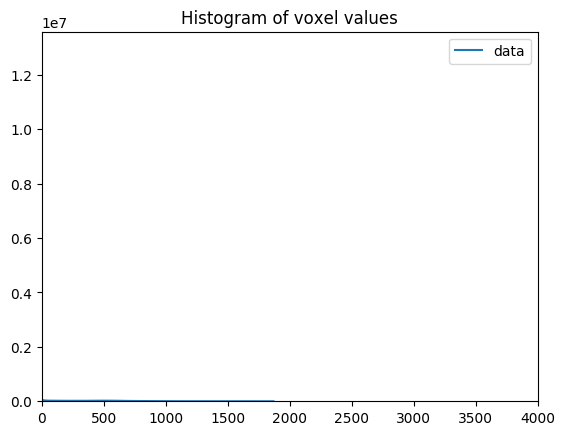

In [86]:
plt.show()

In [25]:
#plt.savefig('his.png')

In [26]:
#objects = (range(len(np.ravel(out_arr))))
#y_pos = np.arange(len(np.ravel(out_arr)))
#performance = np.ravel(out_arr)
 
#plt.bar(y_pos, performance, align='center', alpha=0.5)
#plt.xticks(y_pos, objects)
#plt.ylabel('Value')
#plt.title('Window Value')
 

In [27]:
max_ind = unravel_index(out_arr.argmax(), out_arr.shape)

NameError: name 'unravel_index' is not defined

In [88]:
max_ind

(280, 228, 124)

In [29]:
from skimage import measure
props = measure.regionprops(label_image=trimmed_binary,cache=True)

In [30]:
centroid = props[0].centroid
centroid

(184.79913992803984, 157.61601113904086, 81.551068312878897)

In [31]:
props[0].equivalent_diameter

67.678491326011667

In [32]:
from skimage import morphology as morph
exp = trimmed_binary.copy()
n = 50
k = morph.ball(n)
k.shape

(101, 101, 101)

In [36]:
exp[173-n:173+n+1,146-n:146+n+1,80-n:80+n+1] = 0
exp[173-n:173+n+1,146-n:146+n+1,80-n:80+n+1] = exp[173-n:173+n+1,146-n:146+n+1,80-n:80+n+1] + k
exp[150,146,84] = 0

In [37]:
aw = [go.Heatmap(z = exp[:,:,84])]
iplot(aw,filename='basic-heatmap')

In [33]:
from skimage import measure

In [34]:
verts, faces, normals, values = measure.marching_cubes_lewiner(binary) 

In [34]:
def adjust_sphere(image,centroid):
    x_dim = int(image.shape[0])
    y_dim = int(image.shape[1])
    z_dim = int(image.shape[2])
    xi = int(centroid[0])
    yi = int(centroid[1])
    zi = int(centroid[2])
    image[xi-10:xi+10,yi-10:yi+10,zi-10:zi+10]
    arg_x = np.zeros((x_dim),dtype=int)
    arg_y = np.zeros((y_dim),dtype=int)
    arg_z = np.zeros((z_dim),dtype=int)
    for i in range(xi,5,-1):                        #For reverse X-direction....from centroid to left octant
        conv = image[i-5:i,yi:yi+5,zi:zi+5]
        s = np.sum(conv)
        arg_x[i] = s
        if s>0 and i>11:
            for j in range(i,10,-1):
                conv1 = image[j-10:j,yi:yi+10,zi:zi+10]
                s1 = np.sum(conv1)
                arg_x[j] = s1
    for i in range(xi,x_dim-5+1):                        #For forward X-direction....from centroid to right octant
        conv = image[i:i+5,yi:yi+5,zi:zi+5]
        s = np.sum(conv)
        arg_x[i] = s
        if s>0 and i>11:
            for j in range(i,x_dim-10+1):
                conv1 = image[j:j+10,yi:yi+10,zi:zi+10]
                s1 = np.sum(conv1)
                arg_x[j] = s1
                
    for i in range(yi,5,-1):                        #For reverse Y-direction....from centroid to left octant
        conv = image[xi:xi+5,i-5:i,zi:zi+5]
        s = np.sum(conv)
        arg_y[i] = s
        if s>0 and i>11:
            for j in range(i,10,-1):
                conv1 = image[xi:xi+10,j-10:j,zi:zi+10]
                s1 = np.sum(conv1)
                arg_y[j] = s1
    for i in range(yi,y_dim-5+1):                        #For forward Y-direction....from centroid to right octant
        conv = image[xi:xi+5,i:i+5,zi:zi+5]
        s = np.sum(conv)
        arg_y[i] = s
        if s>0 and i>11:
            for j in range(i,y_dim-10+1):
                conv1 = image[xi:xi+10,j:j+10,zi:zi+10]
                s1 = np.sum(conv1)
                arg_y[j] = s1

    for i in range(zi,5,-1):                        #For reverse Z-direction....from centroid to left octant
        conv = image[xi:xi+5,yi:yi+5,i-5:i]
        s = np.sum(conv)
        arg_z[i] = s
        if s>0 and i>11:
            for j in range(i,10,-1):
                conv1 = image[xi:xi+10,yi:yi+10,j-10:j]
                s1 = np.sum(conv1)
                arg_z[j] = s1
    for i in range(zi,z_dim-5+1):                        #For forward Z-direction....from centroid to right octant
        conv = image[xi:xi+5,yi:yi+5,i:i+5]
        s = np.sum(conv)
        arg_z[i] = s
        if s>0 and i>11:
            for j in range(i,z_dim-10+1):
                conv1 = image[xi:xi+10,yi:yi+10,j:j+10]
                s1 = np.sum(conv1)
                arg_z[j] = s1
                
    x_neg = np.argmax(arg_x[0:xi])
    x_pos = np.argmax(np.append(np.zeros(xi),arg_x[xi:x_dim]))
    y_neg = np.argmax(arg_y[0:yi])
    y_pos = np.argmax(np.append(np.zeros(yi),arg_y[yi:y_dim]))
    z_neg = np.argmax(arg_z[0:zi])
    z_pos = np.argmax(np.append(np.zeros(zi),arg_z[zi:z_dim]))
    print(arg_z)
    return [[x_neg,x_pos],[y_neg,y_pos],[z_neg,z_pos]]


In [35]:
adjust_param = adjust_sphere(trimmed_binary,centroid)

[ 0  0  0  0  0  0 24 24 24  2  2  2 91 91  0  0  0 22 28 25 25 25  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0 21 21 51 51 51 48  0 13 13 13 13 13  0  0  0  0]


In [36]:
adjust_param

[[23, 262], [20, 288], [12, 158]]

In [37]:
import math
dist = [[(centroid[0]-adjust_param[0][0]),(adjust_param[0][1]-centroid[0])],[(centroid[1]-adjust_param[1][0]),(adjust_param[1][1]-centroid[1])],[(centroid[2]-adjust_param[2][0]),(adjust_param[2][1]-centroid[2])]]

In [38]:
km = np.ravel(dist)
km.sort()
km

array([  69.55106831,   76.44893169,   77.20086007,  130.38398886,
        137.61601114,  161.79913993])

In [39]:
ki = int(km[3])
ri = int((ki-1)/2)

In [40]:
exper_1 = trimmed_binary.copy()

In [42]:
ball_1 = morph.ball(ri)

In [41]:
def add_ball(image1,radius,center):
    image = image1.copy()
    ball = morph.ball(radius)
    #print(image.shape)
    x = int(center[0])
    y = int(center[1])
    z = int(center[2])
    image[x-radius:x+radius+1,y-radius:y+radius+1,z-radius:z+radius+1] = -5000*(image[x-radius:x+radius+1,y-radius:y+radius+1,z-radius:z+radius+1] + ball)
    return image

In [42]:
fit_model = add_ball(trimmed_binary,ri,centroid)

In [43]:
df = [go.Heatmap(z = np.flipud(fit_model[:,:,121]))]
iplot(df,filename='da')

In [44]:
def nd_convolution_mod(image2,kernel):
    image = image2.copy()
    print(image.shape)
    r = image.shape
    convolution = np.zeros([(refDS.Rows - 49 + 1),(refDS.Columns - 49 +1),(len(lstDCM) - 49 +1)],dtype = int)
    rowRange = r[0] - 49 + 1
    colRange = r[1] - 49 +1
    depRange = r[2] - 49 +1
    for i in range(0,rowRange):
        for j in range(0,colRange):
            for k in range(0,depRange):
                conv = np.multiply(image[i:i+49,j:j+49,k:k+49],kernel)
                print(conv.shape)
                s = np.sum(conv)
                if s<0:
                    break
                if s>0:
                    convolution[i+33][j+100][k+6] = s
            for l in range(r[2]-1,k+49,-1):
                conv1 = np.multiply(image[i:i+48+1,j:j+48+1,l-49:l],kernel)
                print(conv1.shape)
                s = np.sum(conv1)
                if s<0:
                    break
                if s>0:
                    convolution[i][j][l-49] = s
        
    return convolution

In [45]:
ker = morph.ball(24)
ker.shape

(49, 49, 49)

In [47]:
den_res = nd_convolution_mod(fit_model,ker)

(320, 313, 172)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 

(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)

(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)

(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)

(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)

(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)

(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)

(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)
(49, 49, 49)

KeyboardInterrupt: 

In [161]:
np.save('convoluted',den_res)

In [46]:
from numpy import unravel_index
den_res = np.load('./Sampdata/density_map.npy')

In [47]:
unravel_index(den_res.argmax(),den_res.shape)

(281, 241, 44)

In [48]:
index

NameError: name 'index' is not defined

In [12]:
index = np.asarray(np.where(den_res == 2041)).T

In [50]:
def if_max(convolute,value):
    vote_max = 0
    vote_min = 0
    index = np.asarray(np.where(convolute == value)).T
    if len(index) == 0:
        return
    p = randint(0,len(index)-1)
    init = index[p]
    dim = 5
    window = convolute[init[0]-dim:init[0]+dim,init[1]-dim:init[1]+dim,init[2]-dim:init[2]+dim]
    vote_min = len(np.asarray(np.where(window < value)).T)
    vote_max = len(np.asarray(np.where(window > value)).T)
    face_val = len(np.asarray(np.where(window == value)).T)
    print([vote_min,vote_max,face_val])
    if vote_max == 0 and de_facto > 0:
        return 1
    if vote_max == vote_min:
        return 0.5
    if vote_max > 1:
        return 0    

In [79]:
t = np.asarray(np.where(den_res == 242)).T

In [49]:
exp33 = binary.copy()

In [50]:
exp31 = binary.copy()
exp32 = binary.copy()

In [51]:
k = 249
l = 126
m = 29
#exp3[k:k+48,l:l+48,m:m+48] = 1
#exp3[k,l,m] = 0
#exp3[286:286+49,294:294+49,40:40+49] = 1
exp31[275:275+49,135:135+49,60:60+49] = 1
exp32[57:57+49,178:178+49,48:48+49] = 1
exp32[200:200+49,106:106+49,43:43+49] = 1
exp32[117:117+49,332:332+49,28:28+49] = 1
exp32[108:108+49,101:101+49,79:79+49] = 1
exp32[117:117+49,318:318+49,14:14+49] = 1
exp32[200:200+49,145:145+49,12:12+49] = 1

In [52]:

exp33[230:230+49,321:321+49,10:10+49] = 1
exp33[76:76+49,209:209+49,8:8+49]  =1
exp33[105:105+49,102:102+49,85:85+49] = 1
exp33[38:38+49,219:219+49,74:74+49] = 1
exp33[105:105+49,103:103+49,85:85+49] = 1
exp33[100:100+49,280:280+49,91:91+49] = 0
exp33[164:164+49,364:364+49,97:97+49] = 1
exp33[181:181+49,46:46+49,122:122+49] = 0
exp33[216:216+49,321:321+49,112:112+49] = 0
exp33[174:174+49,128:128+49,119:119+49] = 1
exp33[214:214+49,144:144+49,128:128+49] = 1
exp33[216:216+49,321:321+49,114:114+49] = 0
exp33[105:105+49,239:239+49,129:129+49] = 1
exp33[281:281+35,241:241+35,28:28+35] = 1
exp33[227:227+35,325:325+35,115:115+35] = 1

In [53]:
fas = [go.Heatmap(z = np.flipud(exp33[:,:,161]))]
iplot(fas,filename='dasd')

In [55]:
den_res.max()

2041

In [56]:
k = np.asarray(np.where(den_res == 3412)).T

In [57]:
len(k)

0

In [54]:
def center_shift(convolute,value,factor,iter_max):
    vote_max = 0
    vote_min = 0
    index = np.asarray(np.where(convolute == value)).T
    if len(index) == 0:
        return
    p = randint(0,len(index)-1)
    center = index[p]
    dim = 5
    window = convolute[center[0]-dim:center[0]+dim,center[1]-dim:center[1]+dim,center[2]-dim:center[2]+dim]
    vote_min = len(np.asarray(np.where(window < value)).T)
    vote_max = len(np.asarray(np.where(window > value)).T)
    face_val = len(np.asarray(np.where(window == value)).T)
    print([vote_min,vote_max,face_val])
    if (vote_min/((dim*2)**3)) >= factor:
        return center
        
    if (vote_min/((dim*2)**3)) < factor:
        for i in range(iter_max):
            max_val = window.max()
            print(max_val)
            index = np.asarray(np.where(convolute == max_val)).T
            center = index[randint(0,len(index)-1)]
            window = convolute[center[0]-dim:center[0]+dim,center[1]-dim:center[1]+dim,center[2]-dim:center[2]+dim]
            vote_min = len(np.asarray(np.where(window < max_val)).T)
            vote_max = len(np.asarray(np.where(window > max_val)).T)
            face_val = len(np.asarray(np.where(window == max_val)).T)
            if (vote_min/((dim*2)**3)) >= factor:
                return center     
                break
        
        

In [55]:
cent_nw = center_shift(den_res,3317,0.95,2)

In [56]:
from math import sqrt

In [60]:
den_res[284,231,39]

887

In [57]:
def center_shift2(convolute,tup,factor,iter_max):
    vote_max = 0
    vote_min = 0
    
    if len(tup) == 0:
        return
    value = convolute[tup[0],tup[1],tup[2]]
    center = tup.copy()
    dim = 5
    window = convolute[center[0]-dim:center[0]+dim,center[1]-dim:center[1]+dim,center[2]-dim:center[2]+dim]
    vote_min = len(np.asarray(np.where(window < value)).T)
    vote_max = len(np.asarray(np.where(window > value)).T)
    face_val = len(np.asarray(np.where(window == value)).T)
    print([vote_min,vote_max,face_val])
    if (vote_min/((dim*2)**3)) >= factor:
        return center
        
    if (vote_min/((dim*2)**3)) < factor:
        for i in range(iter_max):
            max_val = window.max()
            print(max_val)
            index = np.asarray(np.where(convolute == max_val)).T
            dist = np.zeros(len(index),dtype = int)
            for i in range(0,len(index)):
                dist[i] = sqrt(((center[0]-index[i][0])**2) + ((center[1]-index[i][1])**2) + ((center[2]-index[i][2])**2))
            k = np.argmin(dist)
        
            center = index[k]
            window = convolute[center[0]-dim:center[0]+dim,center[1]-dim:center[1]+dim,center[2]-dim:center[2]+dim]
            vote_min = len(np.asarray(np.where(window < max_val)).T)
            vote_max = len(np.asarray(np.where(window > max_val)).T)
            face_val = len(np.asarray(np.where(window == max_val)).T)
            if (vote_min/((dim*2)**3)) >= factor:
                return center     
                break
        
        

In [62]:
tup = [281, 241,  24]

In [63]:
cen = center_shift2(den_res,tup,0.99,15)

[986, 13, 1]
1362


In [116]:
l = np.asarray(np.where(den_res == 2041)).T
l[0]

array([281, 241,  44])

In [24]:
den_res[57,178,40]

345

In [30]:
cen

array([281, 241,  28])

In [110]:
den_res.max()

2041

In [79]:
#exp3[282:282+49,232:232+49,38:38+49] = 
den_res[221,341,130]

680

In [158]:
sa = [go.Heatmap(z = np.flipud(np.rot90((cut[:,:,90]))))]
iplot(sa,filename='asds')

In [131]:
den_res[57,178,40],den_res[202,116,40],den_res[200,106,43],den_res[53,207,120]

(345, 518, 623, 845)

In [160]:
tu = [113,364,44]
cen = center_shift2(den_res,tu,0.98,20)

[533, 462, 5]
800
888
919


In [116]:
den_res[301,173,116]

752

In [58]:
def straight_mod(image):
    fixX = int((refDS.Rows)/2)
    fixY = int((refDS.Columns)/2)
    fixZ = int(len(lstDCM)/2)
    i = 0
    j = 0
    k = 0
    l = 0
    m = 0
    n = 0
    for i in range(fixY):
        conv = image[fixX:fixX+5,i:i+5,fixZ:fixZ+5]
        s = np.sum(conv)
        if s>0:
            t1 = [fixX,i,fixZ]
            print(t1)
            break
    for j in range(fixX):
        conv = image[j:j+5,fixY:fixY+5,fixZ:fixZ+5]
        s = np.sum(conv)
        if s>0:
            t2 = [j,fixY,fixZ]
            print(t2)
            break 
    for k in range(int(refDS.Rows),1,-1):
        conv = image[k-5:k,fixY:fixY+5,fixZ:fixZ+5]
        s = np.sum(conv)
        if s>0:
            t3 = [k,fixY,fixZ]
            print(t3)
            break 
    for l in range(int(refDS.Columns),1,-1):
        conv = image[fixX:fixX+5,l-5:l,fixZ:fixZ+5]
        s = np.sum(conv)
        if s>0:
            t4 = [fixX,l,fixZ]
            print(t4)
            break 
    for m in range(fixZ):
        conv = image[fixX:fixX+5,fixY:fixY+5,m:m+5]
        s = np.sum(conv)
        if s>0:
            t5 = [fixX,fixY,m]
            print(t5)
            break
    for n in range(int(len(lstDCM)),0,-1):
        conv = image[fixX:fixX+5,fixY:fixY+5,n-5:n]
        s = np.sum(conv)
        if s>0:
            t6 = [fixX,fixY,n]
            print(t6)
            break        
    return [t1,t2,t3,t4,t5,t6]        
            

In [141]:
def find_all_points(convolute,d,max_iter):
    max_val = convolute.max()
    tups = np.asarray(np.where(convolute == max_val)).T
    #Declaring values around global maxima to zero...
    err_reg = convolute[tups[0][0]-60:tups[0][0]+60,tups[0][1]-160:tups[0][1]+160,tups[0][2]-60:tups[0][2]+60]
    err_reg = 0
    #Getting Initial Seed...
    i_val = straight_mod(convolute)
    for a in range(max_iter):
        fi = center_shift2(i_val[i])
        
    

In [62]:
exp4 = binary.copy()

In [179]:
exp4[54:54+35,195:195+35,109:109+35] = 1
exp4[109:109+35,106:106+35,78:78+35] = 1
exp4[228:228+35,325:325+35,115:115+35] = 1
exp4[164:164+35,366:366+35,115:115+35] = 1
exp4[122:122+35,352:352+35,42:42+35] = 1
exp4[234:234+35,322:322+35,114:114+35] = 1
exp4[221:221+35,161:161+35,125:125+35] = 1
exp4[209:209+35,103:103+35,62:62+35] = 1
exp4[122:122+35,352:352+35,42:42+35] = 1
exp4[109:109+35,292:292+35,103:103+35] = 1
exp4[109:109+35,106:106+35,78:78+35] = 1
exp4[59:59+35,182:182+35,66:66+35] = 1
exp4[54:54+35,195:195+35,109:109+35] = 1
exp4[301:301+35,173:173+35,116:116+35] = 1
exp4[186:186+35,378:378+35,86:86+35] = 1
exp4[159:159+35,109:109+35,49:49+35] = 1
exp4[119:119+35,378:378+35,90:90+35] = 1
exp4[49:49+35,284:284+35,90:90+35] = 1
exp4[127:127+35,245:245+35,128:128+35] = 1
exp4[43:43+35,229:229+35,78:78+35] = 1
exp4[222:222+35,158:158+35,137:137+35] = 1
exp4[125:125+35,317:317+35,16:16+35] = 1
exp4[119:119+35,337:337+35,32:32+35] = 1

In [181]:
da = [go.Heatmap(z = np.flipud(exp4[:,:,48]))]
iplot(da, filename='heat')

In [61]:
cut = den_res.copy()

In [62]:
from skimage import morphology as morph
fit = morph.ball(30)
cut[281-60:281+60,241-160:241+160,44-30:44+60] = 0

In [63]:
from math import sqrt
sqrt((121-66)**2 + (353-293)**2)

81.39410298049853

In [64]:
from skimage import feature

In [65]:
peaks = feature.peak_local_max(cut,min_distance=25,threshold_abs=800,indices=True,num_peaks=20)

In [82]:
np.save('results_1',peaks) 

In [123]:
peaks1 = feature.peak_local_max(cut,min_distance=25,threshold_abs=700,indices=True,num_peaks=20)

In [124]:
peaks1

array([[301, 173, 116],
       [234, 322, 114],
       [221, 161, 125],
       [209, 103,  62],
       [186, 378,  86],
       [159, 109,  49],
       [122, 352,  42],
       [119, 378,  90],
       [109, 292, 103],
       [109, 106,  78],
       [ 59, 182,  66],
       [ 54, 195, 109],
       [ 49, 284,  90],
       [ 49, 284,  89]])

In [85]:
np.save('results_2',peaks1)

In [125]:
peaks2 = feature.peak_local_max(cut,min_distance=25,threshold_abs=785,indices=True,num_peaks=20)

In [127]:
np.save('results_3',peaks2)

In [130]:
peaks3 = feature.peak_local_max(cut,min_distance=20,threshold_abs=785,indices=True,num_peaks=20)

In [132]:
peaks3

array([[234, 322, 114],
       [221, 161, 125],
       [209, 103,  62],
       [127, 245, 128],
       [122, 352,  42],
       [119, 378,  90],
       [109, 292, 103],
       [109, 106,  78],
       [ 59, 182,  66],
       [ 54, 195, 109],
       [ 43, 229,  78]])

In [159]:
np.save('results_4',peaks3)

In [66]:
peaks4 = feature.peak_local_max(cut,min_distance=10,threshold_abs=785,indices=True,num_peaks=20)

In [67]:
peaks4

array([[234, 322, 114],
       [222, 158, 137],
       [222, 157, 138],
       [221, 161, 125],
       [209, 103,  62],
       [127, 245, 128],
       [125, 317,  16],
       [122, 352,  42],
       [119, 378,  90],
       [119, 337,  32],
       [119, 336,  33],
       [109, 292, 103],
       [109, 106,  78],
       [ 59, 182,  66],
       [ 54, 195, 109],
       [ 43, 229,  78]])

In [184]:
np.save('results_ult',peaks4)

In [68]:
def find_seeds(lst,window):
    np.
    for corner in lst:
        c2 = np.add(p,[35,35,35])
        k = 0.0
        sums = np.array([])
        while(1):
            d = k*[35,35,35]
            r1 = (np.add(corner,d))
            r = [int(r1[0]),int(r1[1]),int(r1[2])]
            window = binary[r[0]:r[0]+5,r[1]:r[1]+5,r[2]:r[2]+5]
            val = np.sum(window)
            np.append(sums,val)
            k = k + 0.1
            w = int(k)
            if w == 1:
                break
        l = np.argmax(sums)
        

In [72]:
p = np.array([])
p = [1,2,3]

In [96]:
l = (np.add(p,[0.3,0.4,0.5]))
l1 = [int(l[0]),int(l[1]),int(l[2])]
np.append(l1,2)

array([1, 2, 3, 2])

In [91]:
i = 0.0
while(1):
    print(i)
    i = i+0.1
    w = int(i)
    if w == 1:
        break
        

0.0
0.1
0.2
0.30000000000000004
0.4
0.5
0.6
0.7
0.7999999999999999
0.8999999999999999
0.9999999999999999
